In [4]:
import h5py
import numpy as np
import matplotlib.pyplot as plt

# Path to your .mat file
file_path = r"D:\BTP\sub-1_ses-1_task-bcimici_meg.mat"

with h5py.File(file_path, 'r') as f:
    # Step 1: Navigate into the 'dataMAT' struct
    data = f['dataMAT']

    # Step 2: Access the 'trial' field which is a 1x200 cell
    trial_refs = data['trial'][0]  # this gives array of references (200,)
    print(trial_refs.shape)
    # Step 3: Choose first trial
    first_trial_ref = trial_refs[0]
    first_trial = f[first_trial_ref][2001:6001] # Shape: (channels, timepoints)

    

    print("Shape of first trial:", first_trial.shape)

    

(1,)
Shape of first trial: (4000, 306)


In [5]:
import h5py
import numpy as np

file_path = r"D:\BTP\sub-1_ses-1_task-bcimici_meg.mat"

with h5py.File(file_path, 'r') as f:
    data = f['dataMAT']

    # 'trial' is a cell array (probably shape: (1, 200)), so transpose it to access each cell
    trial_refs = data['trial']
    print("trial_refs shape:", trial_refs.shape)  # Likely (1, 200)

    # Get the reference to the first trial
    first_trial_ref = trial_refs[0, 0]  # Correct access
    first_trial_data = f[first_trial_ref][:]  # Read the full trial data

    print("Shape of first trial:", first_trial_data.shape)


trial_refs shape: (200, 1)
Shape of first trial: (7000, 306)


In [7]:
import numpy as np
from scipy.fftpack import fft, ifft, fftshift, ifftshift

def MVMD(signal, alpha, tau, K, DC, init, tol):
    x, y = signal.shape
    if x > y:
        C = y
        signal = signal.T
    else:
        C = x

    T = signal.shape[1]
    t = np.arange(1, T + 1) / T
    freqs = t - 0.5 - 1 / T

    # FFT of the signal
    f_hat = fftshift(fft(signal, axis=1))
    f_hat_plus = f_hat.copy()
    f_hat_plus[:, :T//2] = 0  # Set the negative frequencies to zero

    # Initialization
    N = 500
    Alpha = alpha * np.ones(K)
    u_hat_plus = np.zeros((N, len(freqs), K, C), dtype=complex)
    omega_plus = np.zeros((N, K))

    if init == 1:
        omega_plus[0, :] = (0.5 / K) * np.arange(K)
    elif init == 2:
        omega_plus[0, :] = np.sort(np.exp(np.log(1 / T) + (np.log(0.5) - np.log(1 / T)) * np.random.rand(K)))
    else:
        omega_plus[0, :] = 0

    if DC:
        omega_plus[0, 0] = 0

    lambda_hat = np.zeros((N, len(freqs), C), dtype=complex)
    uDiff = tol + np.finfo(float).eps
    n = 0
    sum_uk = np.zeros((C, len(freqs)), dtype=complex)

    # Main algorithm
    while uDiff > tol and n < N:
        k = 0
        for c in range(C):
            sum_uk[c, :] = u_hat_plus[n, :, K-1, c] + sum_uk[c, :] - u_hat_plus[n, :, k, c]
            u_hat_plus[n+1, :, k, c] = (f_hat_plus[c, :] - sum_uk[c, :] - lambda_hat[n, :, c] / 2) / (1 + Alpha[k] * (freqs - omega_plus[n, k])**2)

        if not DC:
            temp1 = 0
            temp2 = 0
            for c in range(C):
                numerator = np.sum(freqs * np.abs(u_hat_plus[n+1, :, k, c])**2)
                denominator = np.sum(np.abs(u_hat_plus[n+1, :, k, c])**2)
                temp1 += numerator
                temp2 += denominator
            omega_plus[n+1, k] = temp1 / temp2

        for k in range(1, K):
            for c in range(C):
                sum_uk[c, :] = u_hat_plus[n+1, :, k-1, c] + sum_uk[c, :] - u_hat_plus[n, :, k, c]
                u_hat_plus[n+1, :, k, c] = (f_hat_plus[c, :] - sum_uk[c, :] - lambda_hat[n, :, c] / 2) / \
                                          (1 + Alpha[k] * (freqs - omega_plus[n, k])**2)

            temp1 = 0
            temp2 = 0
            for c in range(C):
                numerator = np.sum(freqs * np.abs(u_hat_plus[n+1, :, k, c])**2)
                denominator = np.sum(np.abs(u_hat_plus[n+1, :, k, c])**2)
                temp1 += numerator
                temp2 += denominator
            omega_plus[n+1, k] = temp1 / temp2

        for c in range(C):
            lambda_hat[n+1, :, c] = lambda_hat[n, :, c] + tau * (np.sum(u_hat_plus[n+1, :, :, c], axis=1) - f_hat_plus[c, :])

        n += 1

        uDiff = np.finfo(float).eps
        for i in range(K):
            for c in range(C):
                uDiff += np.sum((u_hat_plus[n, :, i, c] - u_hat_plus[n-1, :, i, c]) * \
                                np.conj(u_hat_plus[n, :, i, c] - u_hat_plus[n-1, :, i, c]))
        uDiff = np.abs(uDiff)

    N = min(N, n)
    omega = omega_plus[:N, :]

    u_hat = np.zeros((T, K, C), dtype=complex)
    for c in range(C):
        u_hat[:, :, c] = u_hat_plus[N, :, :, c]

    u = np.zeros((K, T, C))
    for k in range(K):
        for c in range(C):
            u[k, :, c] = np.real(ifft(ifftshift(u_hat[:, k, c])))

    u_hat = np.zeros((len(freqs), K, C), dtype=complex)
    for k in range(K):
        for c in range(C):
            u_hat[:, k, c] = fftshift(fft(u[k, :, c]))

    u_hat = np.transpose(u_hat, (1, 0, 2))

    return u, u_hat, omega


In [9]:
# Parameters
alpha = 2000
tau = 0
K = 10
DC = True
init = 1
tol = 1e-6

# Generate a sample multivariate signal
#L = X.shape[1]
#C = X.shape[0]
#signal = np.sin(np.random.randn(C, L))
#signal=X.T
# Call MVMD
u, u_hat, omega = MVMD(first_trial, alpha, tau, K, DC, init, tol)

MemoryError: Unable to allocate 91.2 GiB for an array with shape (500, 4000, 10, 306) and data type complex128

In [4]:
u.shape

(4, 4000, 306)

In [5]:
from scipy.io import savemat
savemat('mvmd_first_trial_N10_K04.mat', {'u': u, 'u_hat': u_hat, 'omega': omega})


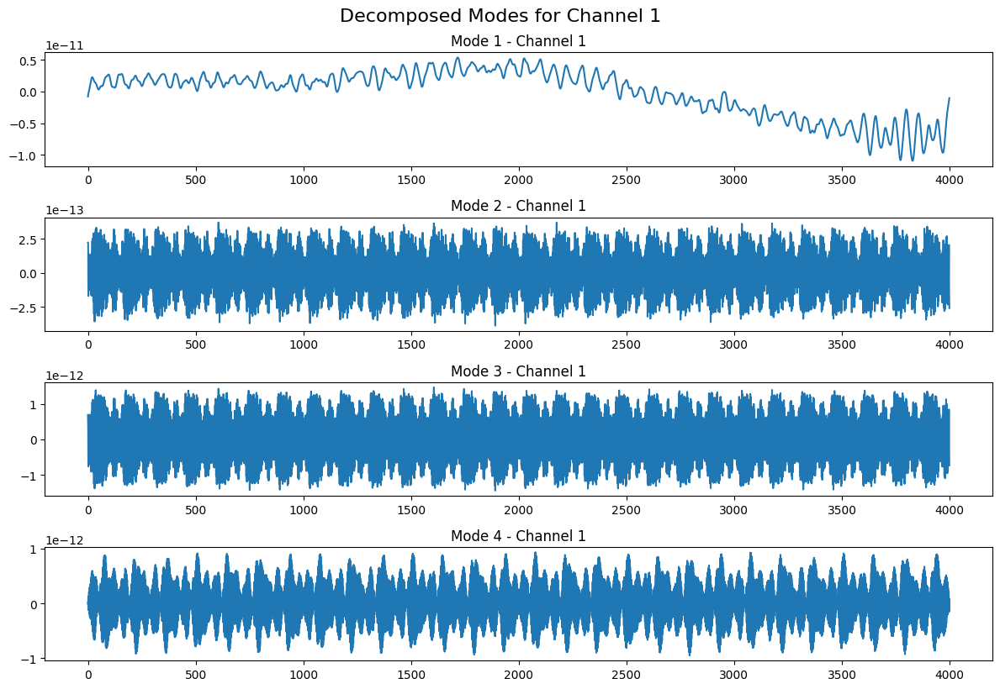

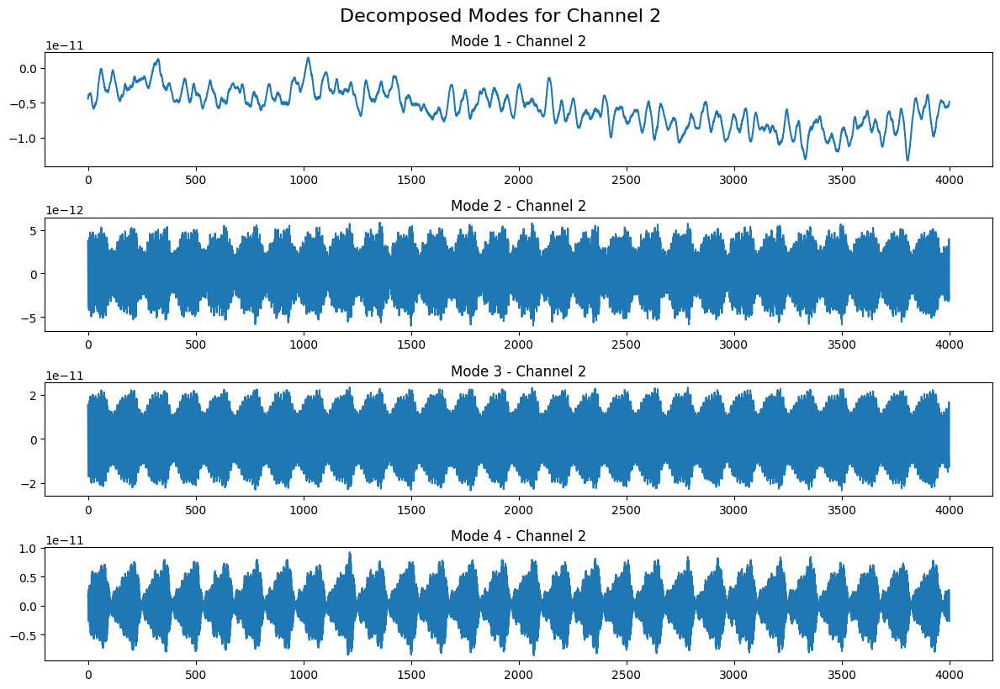

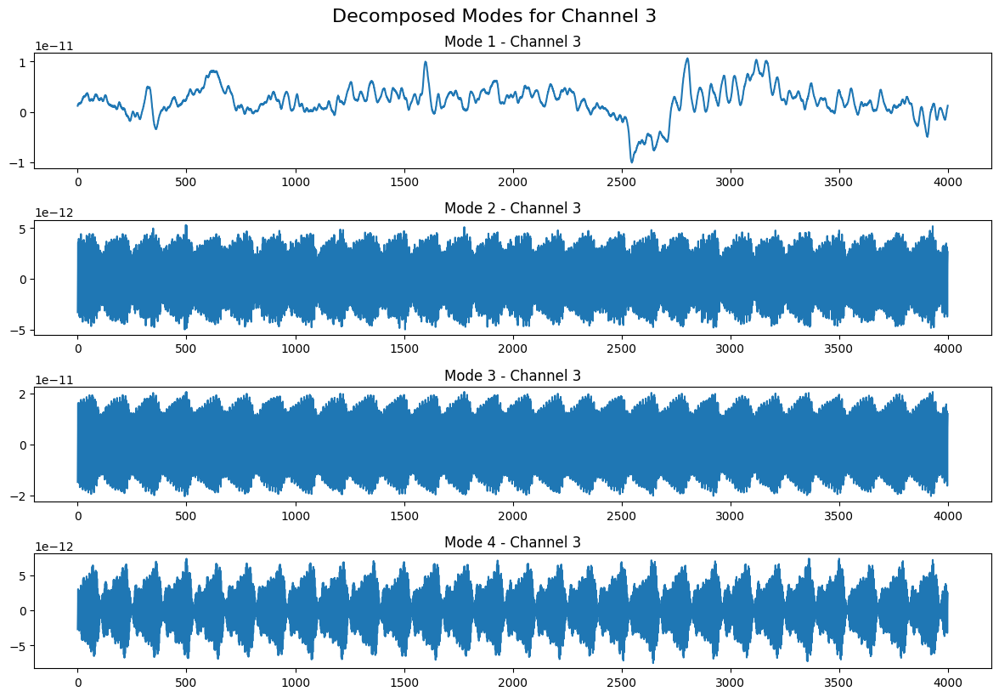

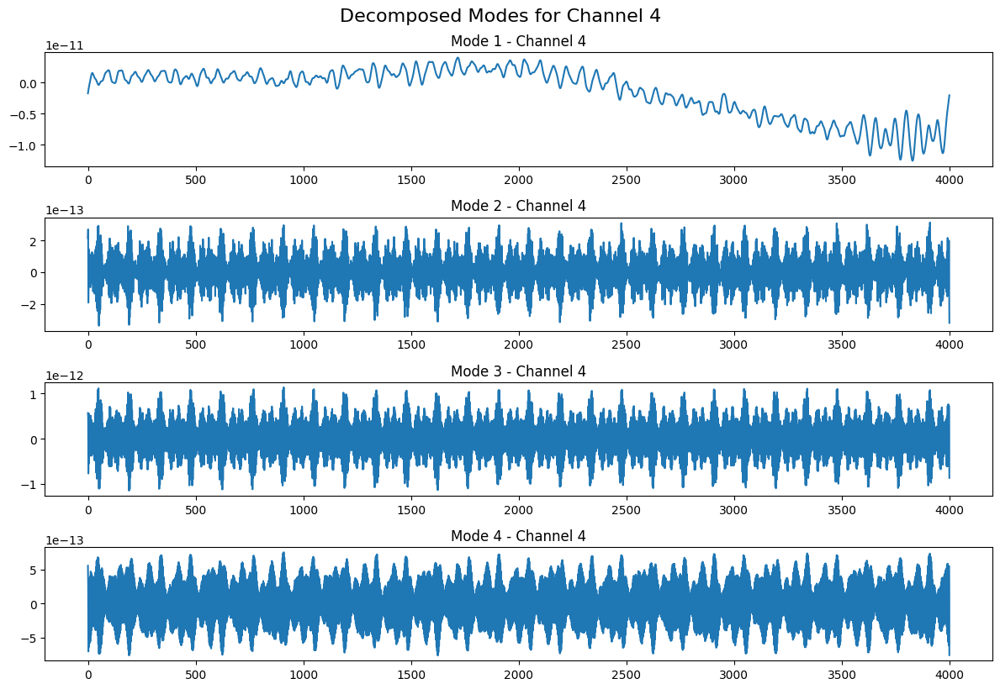

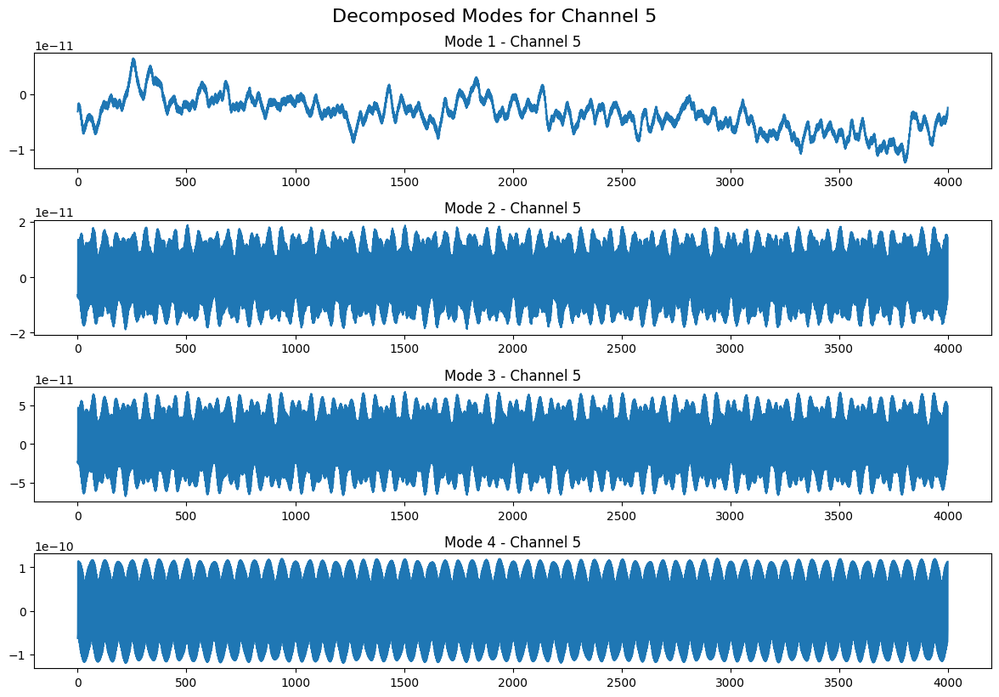

...

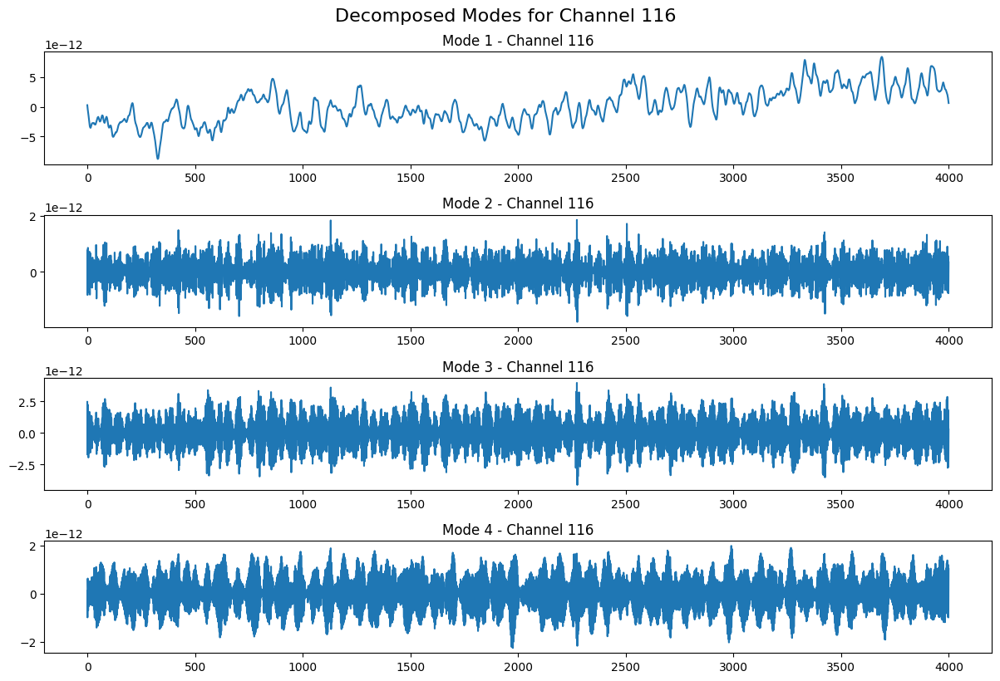

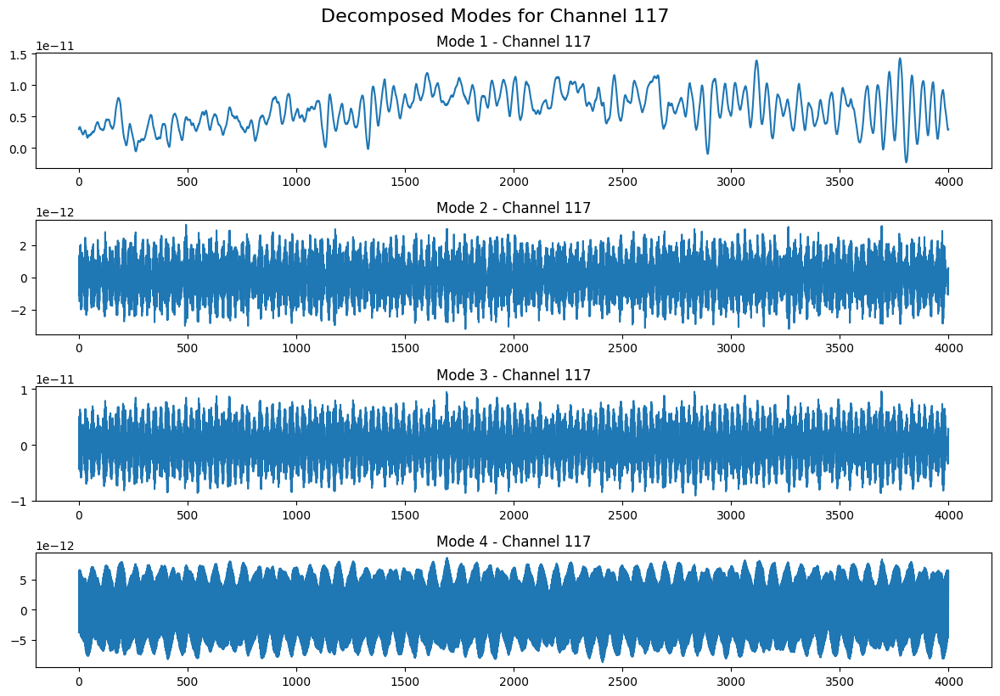

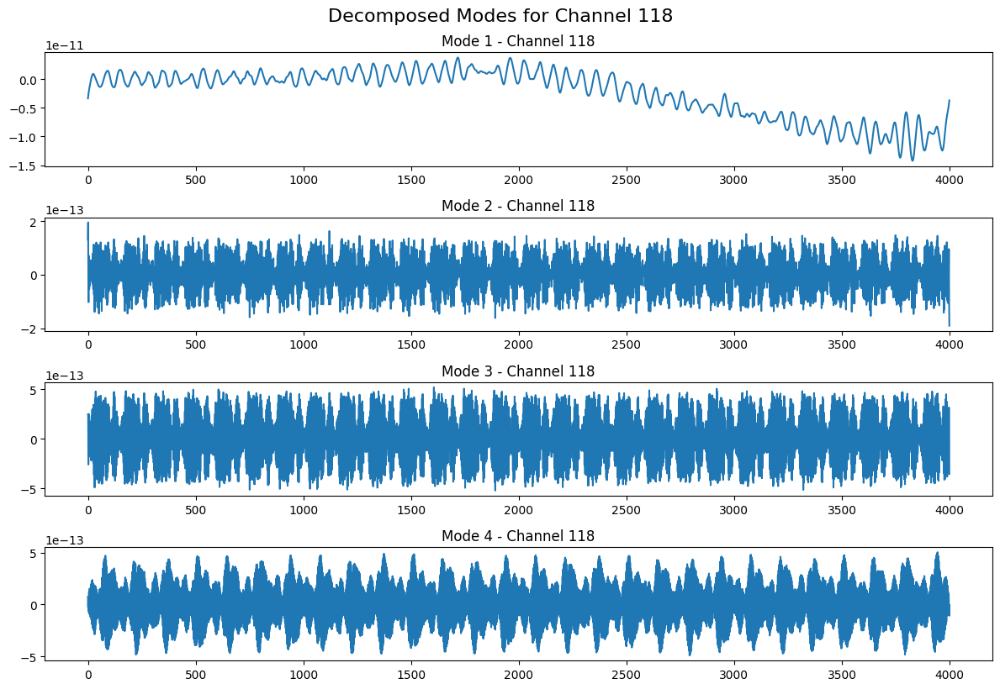

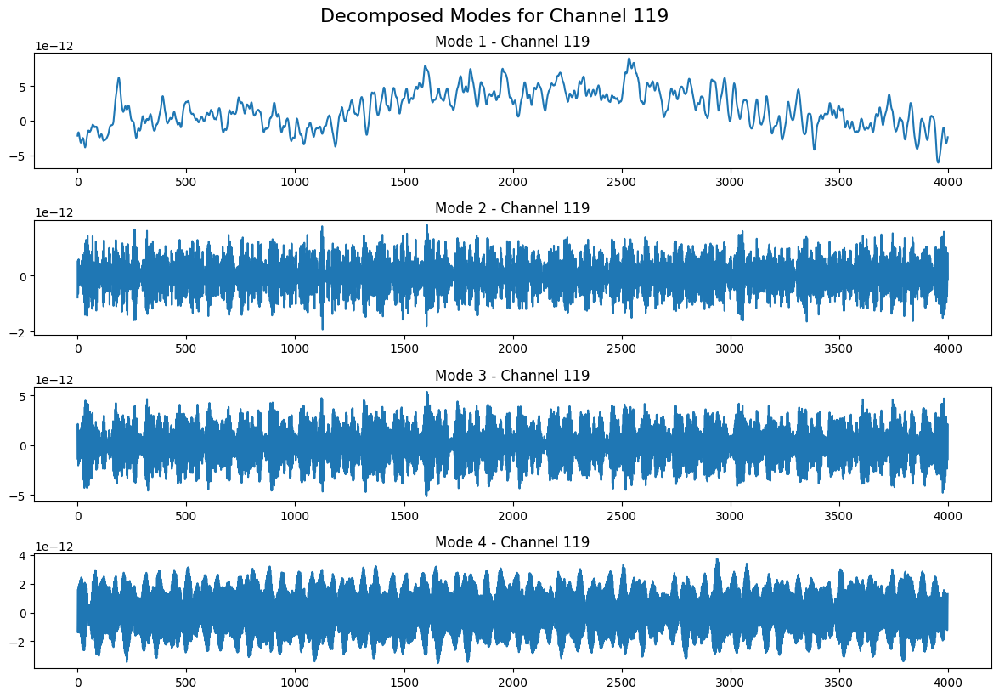

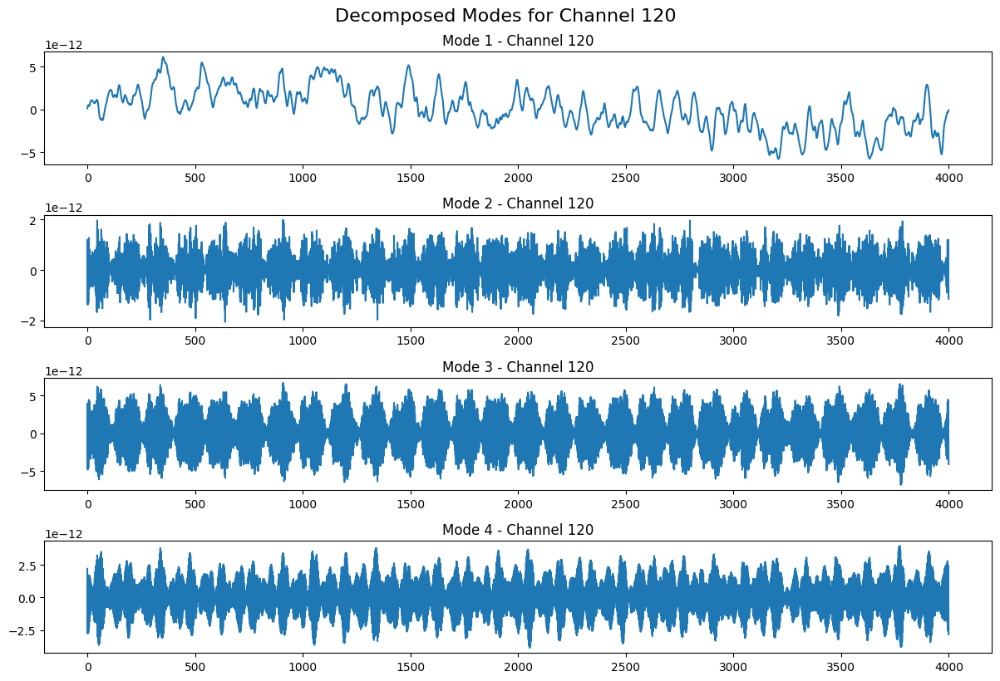

KeyboardInterrupt: 

In [6]:
import matplotlib.pyplot as plt

# Assuming `u` has shape (K, T, C)
K, T, C = u.shape
time = np.arange(T)

# Plot each mode for each channel
for c in range(C):
    plt.figure(figsize=(12, 8))
    for k in range(K):
        plt.subplot(K, 1, k + 1)
        plt.plot(time, u[k, :, c])
        plt.title(f'Mode {k + 1} - Channel {c + 1}')
        plt.tight_layout()
    plt.suptitle(f'Decomposed Modes for Channel {c + 1}', fontsize=16, y=1.02)
    plt.show()
